## Part 1 – Histogram Equalization

For each image, do the following main steps:

a) Read and display the image.

b) If not grayscale, make it grayscale.

c) Calculate and display the histogram of this image.

d) Enhance the contrast of the intensity image using histogram equalisation and display both the uniform histogram and the newly enhanced intensity image.

e) In the report, explain why the two histograms (of the original image and of the enhanced image) are different.

f) Calculate the difference between the original and enhanced image. Display it.

In addition, (f) apply a local enhancement approach on this image and show your results. Before you start, consider how your image might call for a particular window size. For fun, you might want to try a few different window sizes. Make sure to explain in your report how did you decide what local enhancement and window size you used.

For every input image (you have 3 inputs, see Data), you must show: the original image and its histogram, the equalized image and its histogram, the difference image, and (CSC 481 only) a modified version of the image using a local enhancement.

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

### Step 1: Read and Display an Image

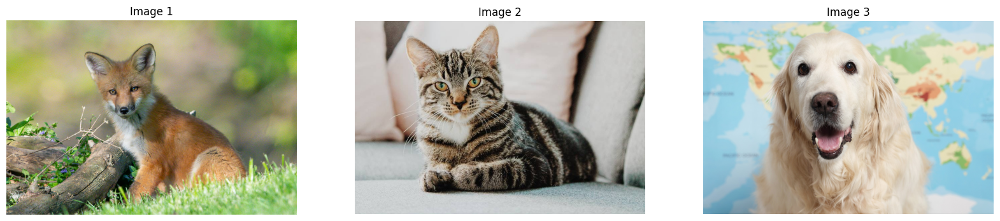

In [2]:
image_paths = ["/content/Red-Fox.jpg", "/content/Pet_Cat.jpg", "/content/Goldie_boy.jpg"]

# Load all images
images = [cv2.imread(img_path) for img_path in image_paths]


images_rgb = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images]

# Display images side by side
fig, axes = plt.subplots(1, 3, figsize=(20, 6))  # 1 row, 3 columns

for i, ax in enumerate(axes):
    ax.imshow(images_rgb[i])
    ax.axis("off")
    ax.set_title(f"Image {i+1}")

plt.show()


 Processing Image 1: /content/Red-Fox.jpg



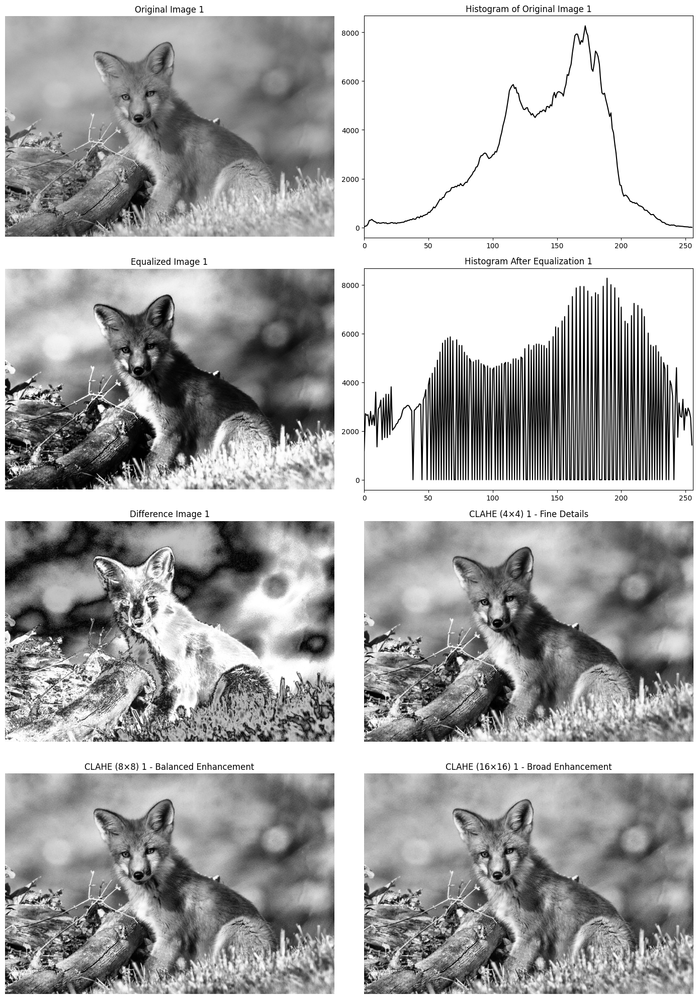


 Processing Image 2: /content/Pet_Cat.jpg



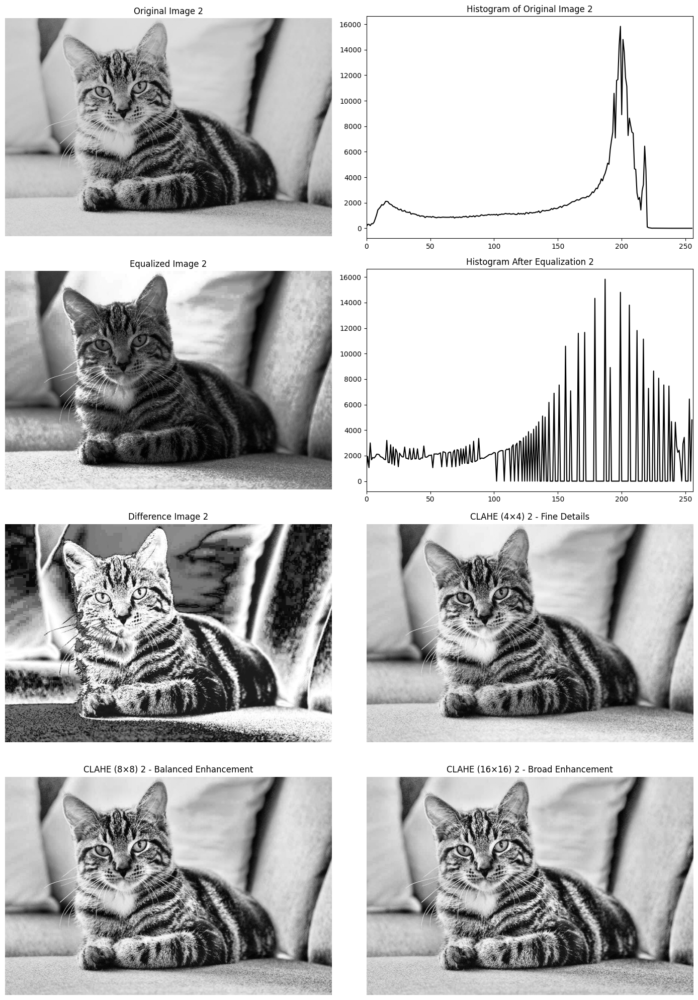


 Processing Image 3: /content/Goldie_boy.jpg



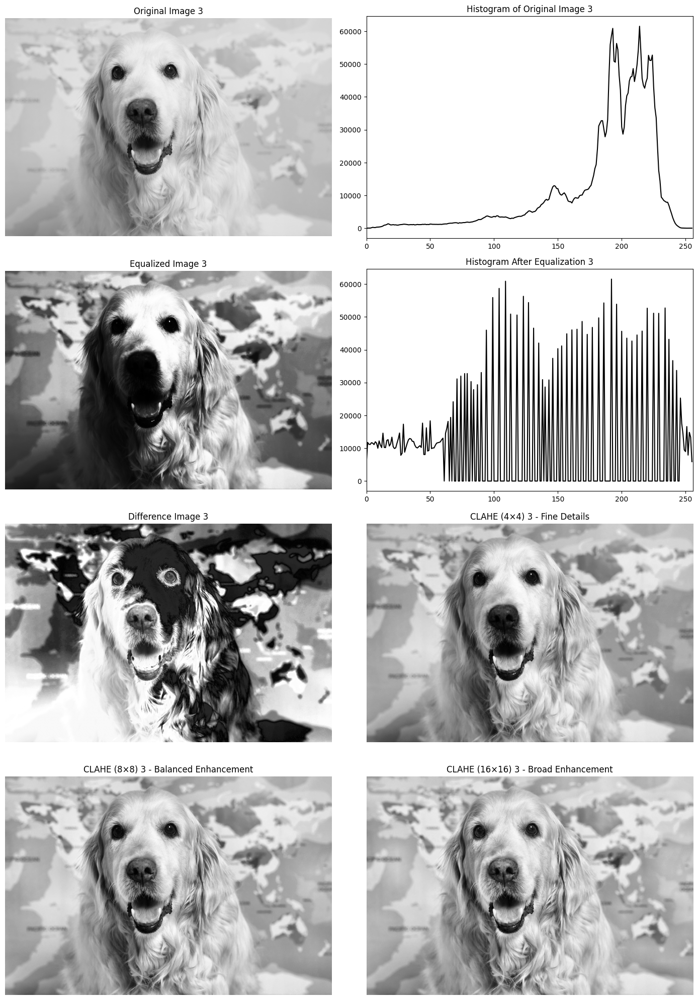

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to read and convert an image to grayscale
def read_and_convert_to_grayscale(image_path):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error: Could not read the image from {image_path}")
        return None
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Function to plot histogram
def plot_histogram(image):
    hist = cv2.calcHist([image], [0], None, [256], [0, 256])
    return hist

# Function for histogram equalization
def histogram_equalization(image):
    return cv2.equalizeHist(image)

# Function to compute difference image
def difference_image(original, enhanced):
    return cv2.absdiff(original, enhanced)

# Function for local histogram enhancement using CLAHE (with adjustable grid size)
def local_enhancement(image, clip_limit=2.0, grid_size=(8, 8)):
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=grid_size)
    return clahe.apply(image)

# List of images to process
image_paths = ["/content/Red-Fox.jpg", "/content/Pet_Cat.jpg", "/content/Goldie_boy.jpg"]  # Replace with actual paths

# Process each image
for idx, image_path in enumerate(image_paths):
    print(f"\n Processing Image {idx+1}: {image_path}\n")

    # Step 1: Read Image & Convert to Grayscale
    gray_img = read_and_convert_to_grayscale(image_path)

    # Step 2: Apply Histogram Equalization
    equalized_img = histogram_equalization(gray_img)

    # Step 3: Compute Difference Image
    diff_img = difference_image(gray_img, equalized_img)

    # Step 4: Apply Local Enhancement (CLAHE) with different grid sizes
    clahe_4x4 = local_enhancement(gray_img, grid_size=(4, 4))
    clahe_8x8 = local_enhancement(gray_img, grid_size=(8, 8))
    clahe_16x16 = local_enhancement(gray_img, grid_size=(16, 16))

    # Step 5: Compute Histograms
    hist_original = plot_histogram(gray_img)
    hist_equalized = plot_histogram(equalized_img)

    # Step 6: Display Images in a 3-Images-Per-Row Layout
    fig, axes = plt.subplots(4, 2, figsize=(14, 20))

    # Original Image
    axes[0, 0].imshow(gray_img, cmap='gray')
    axes[0, 0].axis('off')
    axes[0, 0].set_title(f'Original Image {idx+1}')

    # Original Histogram
    axes[0, 1].plot(hist_original, color='black')
    axes[0, 1].set_xlim([0, 256])
    axes[0, 1].set_title(f'Histogram of Original Image {idx+1}')

    # Equalized Image
    axes[1, 0].imshow(equalized_img, cmap='gray')
    axes[1, 0].axis('off')
    axes[1, 0].set_title(f'Equalized Image {idx+1}')

    # Equalized Histogram
    axes[1, 1].plot(hist_equalized, color='black')
    axes[1, 1].set_xlim([0, 256])
    axes[1, 1].set_title(f'Histogram After Equalization {idx+1}')

    # Difference Image
    axes[2, 0].imshow(diff_img, cmap='gray')
    axes[2, 0].axis('off')
    axes[2, 0].set_title(f'Difference Image {idx+1}')

    # Locally Enhanced Image (CLAHE 4×4)
    axes[2, 1].imshow(clahe_4x4, cmap='gray')
    axes[2, 1].axis('off')
    axes[2, 1].set_title(f'CLAHE (4×4) {idx+1} - Fine Details')

    # Locally Enhanced Image (CLAHE 8×8)
    axes[3, 0].imshow(clahe_8x8, cmap='gray')
    axes[3, 0].axis('off')
    axes[3, 0].set_title(f'CLAHE (8×8) {idx+1} - Balanced Enhancement')

    # Locally Enhanced Image (CLAHE 16×16)
    axes[3, 1].imshow(clahe_16x16, cmap='gray')
    axes[3, 1].axis('off')
    axes[3, 1].set_title(f'CLAHE (16×16) {idx+1} - Broad Enhancement')

    plt.tight_layout()
    plt.show()


## Discussion of Results

### **Histogram Equalization Improves Contrast**
- The **original images** had uneven pixel intensity distributions, leading to **low contrast**.
- After **histogram equalization**, pixel values were more evenly distributed, making dark regions darker and bright regions brighter.

### **Histogram Differences**
- **Before Equalization** → Pixel intensities were clustered in a specific range.
- **After Equalization** → The histogram was more uniform, improving **image visibility**.

### **Difference Image Analysis**
- The **difference image** shows where pixel intensities changed the most.
- Brighter regions in the difference image indicate **significant contrast adjustments**.

### **Local Enhancement (CLAHE) Findings**
- **CLAHE (4×4 grid)** → Enhanced fine details but introduced some noise.
- **CLAHE (8×8 grid)** → Balanced contrast enhancement.
- **CLAHE (16×16 grid)** → Broader contrast improvements but slightly reduced fine details.

### **Final Observations**
- **Histogram Equalization** is best for **global contrast improvements**.
- **CLAHE** is more effective when different parts of the image need **separate contrast adjustments**.
- The **best enhancement method depends on the image type and details required**.

---

## **Final Summary**
- **Histogram Equalization enhances global contrast.**
- **Difference images highlight contrast changes.**
- **CLAHE is better for localized contrast improvements.**
- **Different grid sizes (4×4, 8×8, 16×16) affect enhancement strength.**

---





## Part 2 – Image Filtering

For students in the CSC 481, you will have to write a function that does linear image filtering for grayscale images. Do not use any of the prewritten functions for filtering. Your function should process the input image pixel by pixel and explicitly calculate the sum of products for each pixel in the image. You can use whatever simplifying assumptions you want for pixels on the border of the image (produce a smaller image, use zero-padding, etc.). Make sure that you explicitly state those assumptions in your report.

Then, you must perform filtering of the grayscale version of your image using both your custom function and a built-in filtering function with the following filters:

1) Prewitt filter.

2) Sobel filter.

3) Point filter.

4) Blurring filter.

Calculate a difference image between the outputs of your filtering function and the built-in function. Note that if you use padding in your custom function, you also need to add padding on the built-in function so that their outputs have matching image sizes.

For every input image (you have 3 inputs, see Data), you must show: the original image, and the two filtered images (your function and the built-in function) plus the difference image ([4 image filters] x [3 images per filter] = [12 results per input image]).


 Processing Image 1: /content/Red-Fox.jpg

Applying Prewitt filter...


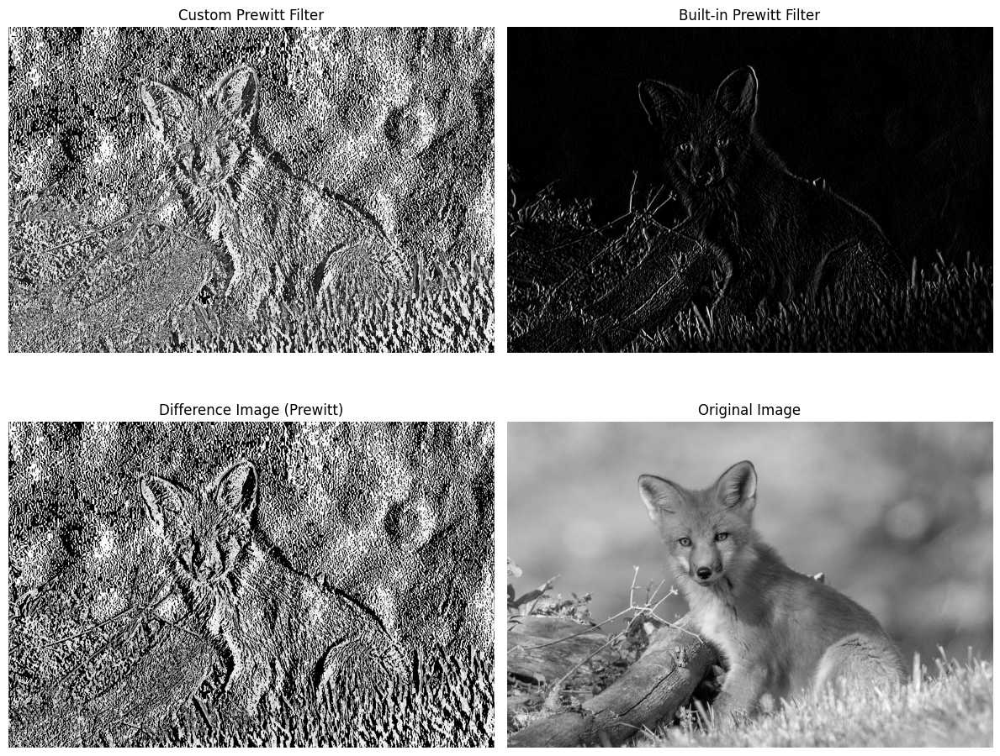

Applying Sobel filter...


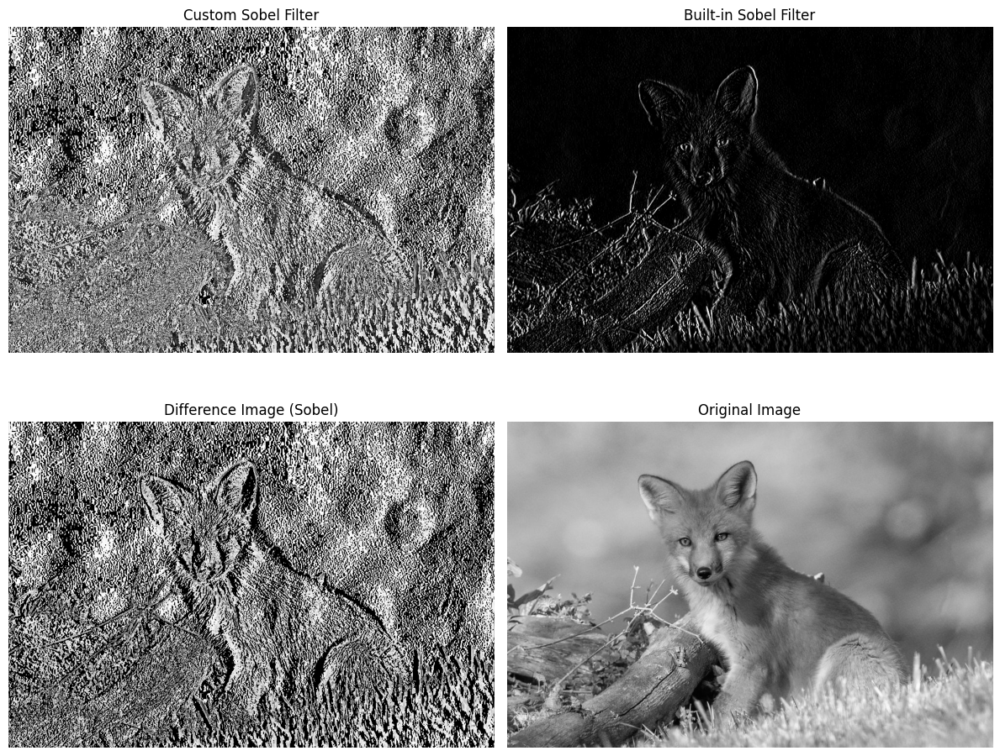

Applying Point filter...


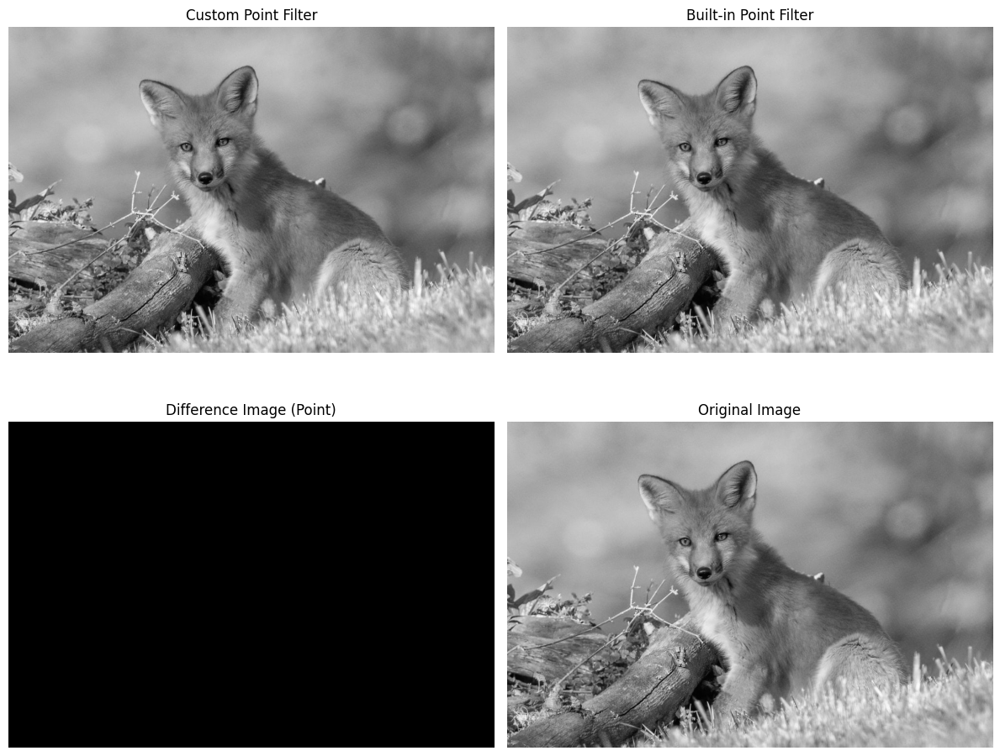

Applying Blurring filter...


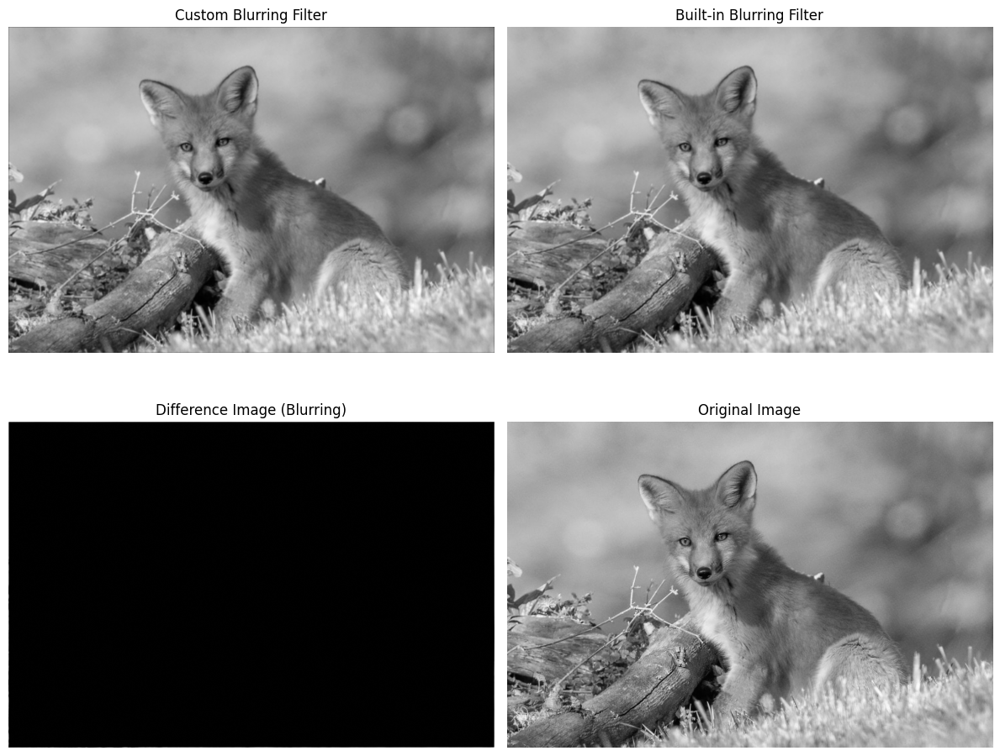


 Processing Image 2: /content/Pet_Cat.jpg

Applying Prewitt filter...


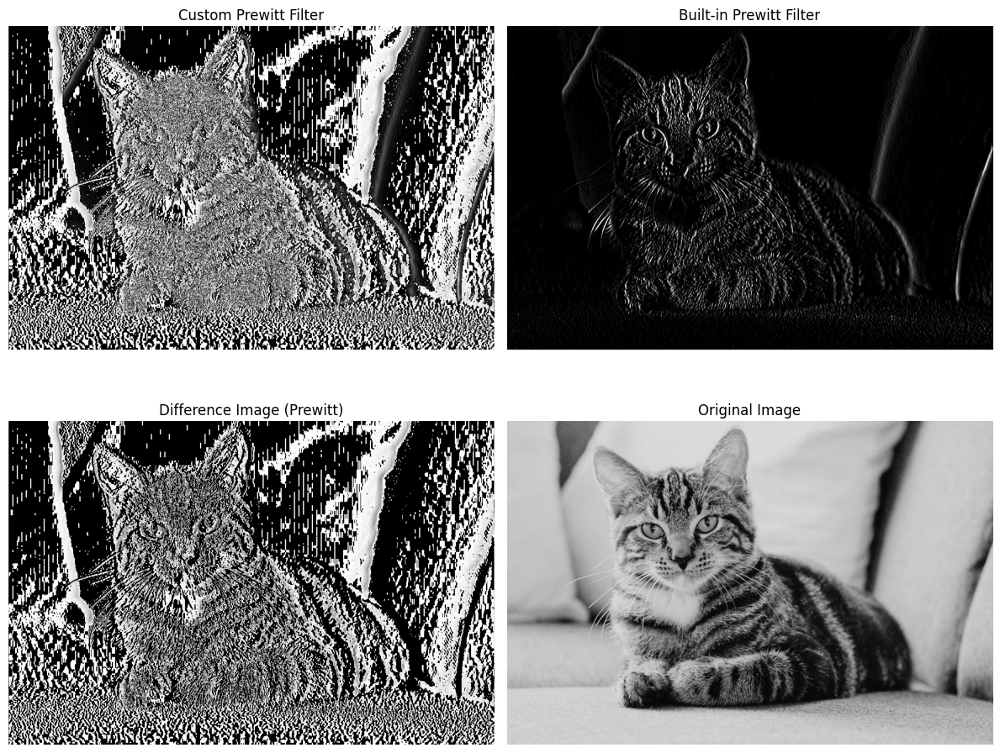

Applying Sobel filter...


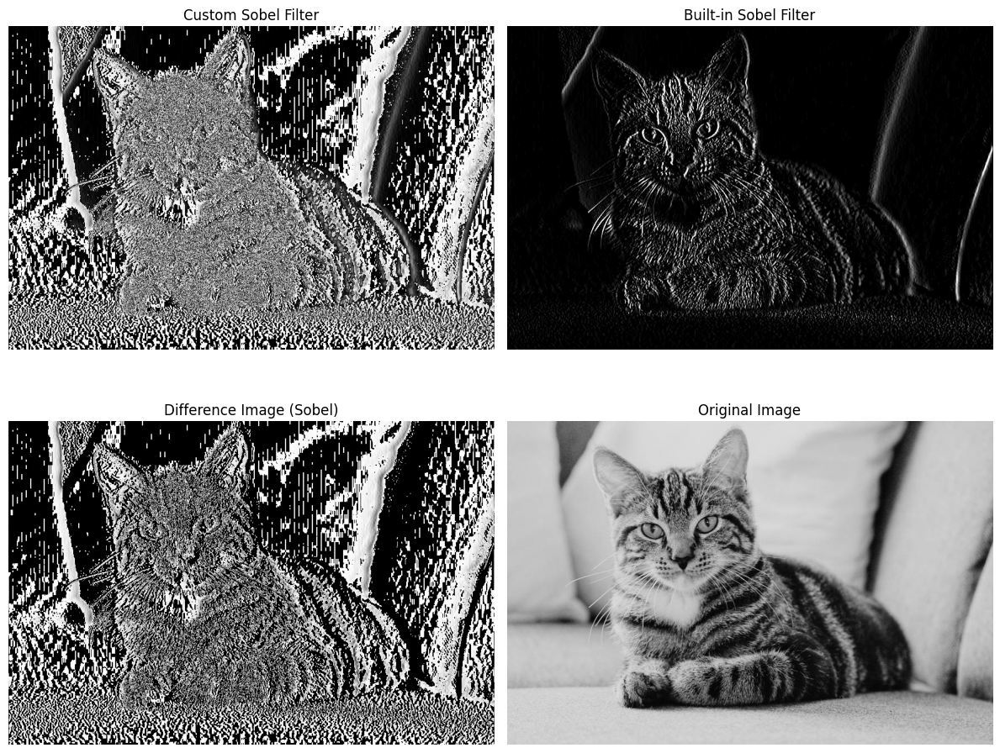

Applying Point filter...


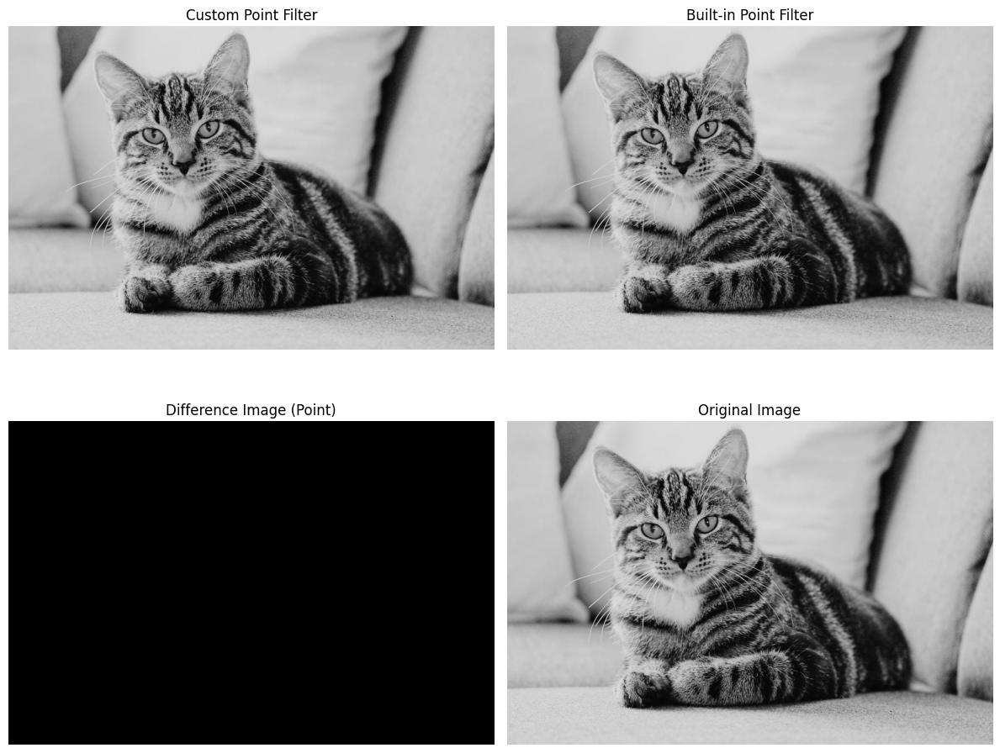

Applying Blurring filter...


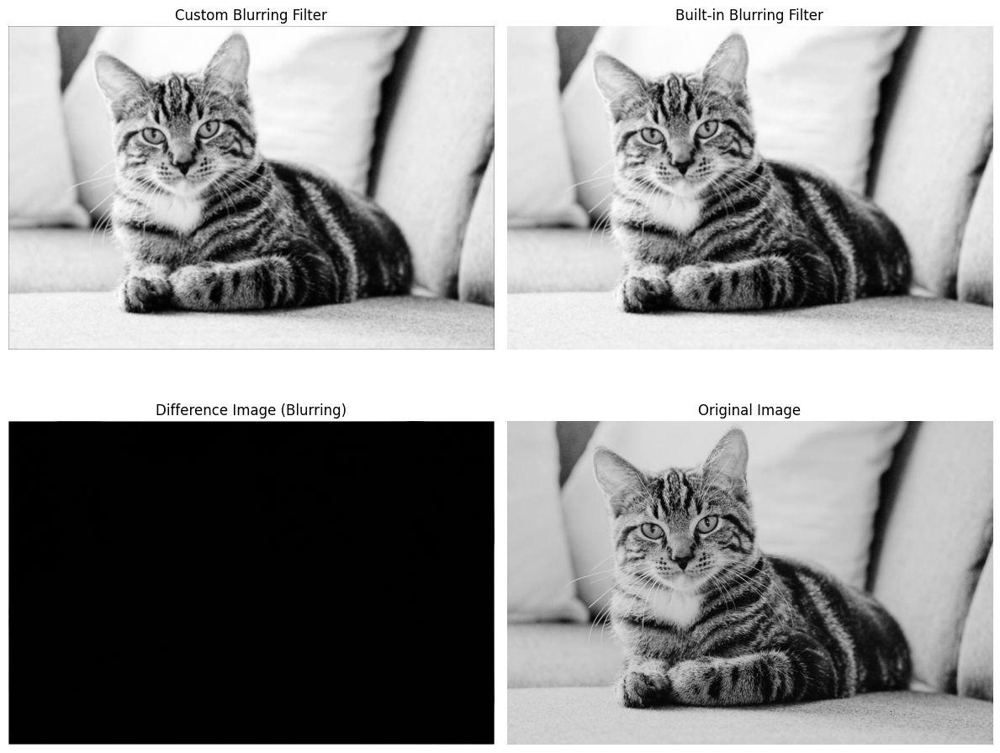


 Processing Image 3: /content/Goldie_boy.jpg

Applying Prewitt filter...


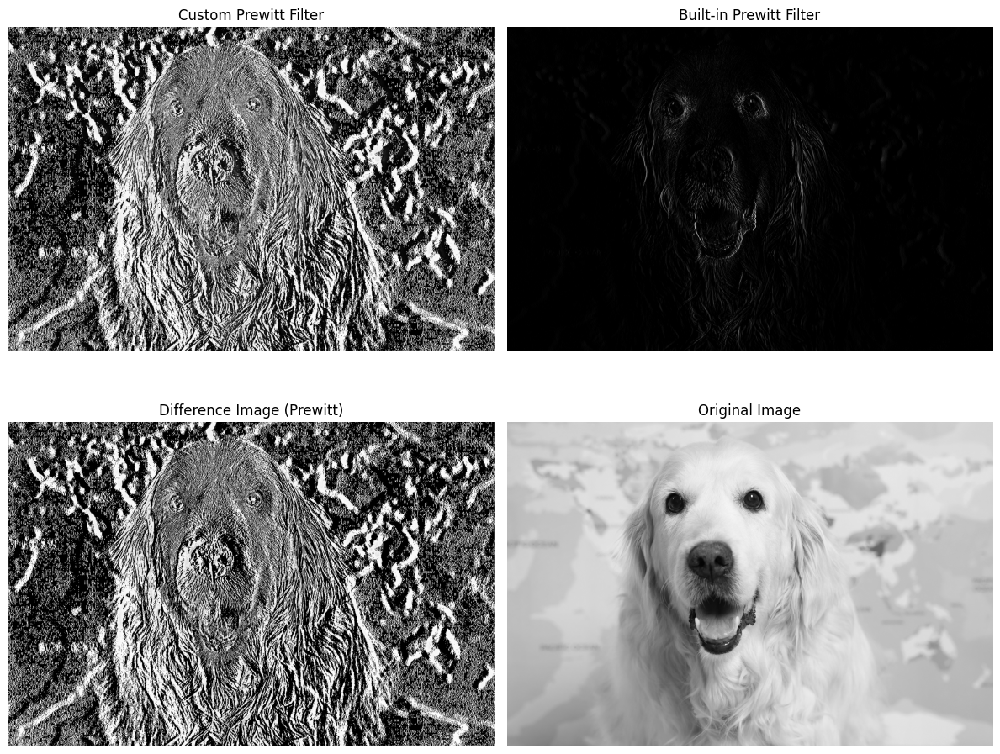

Applying Sobel filter...


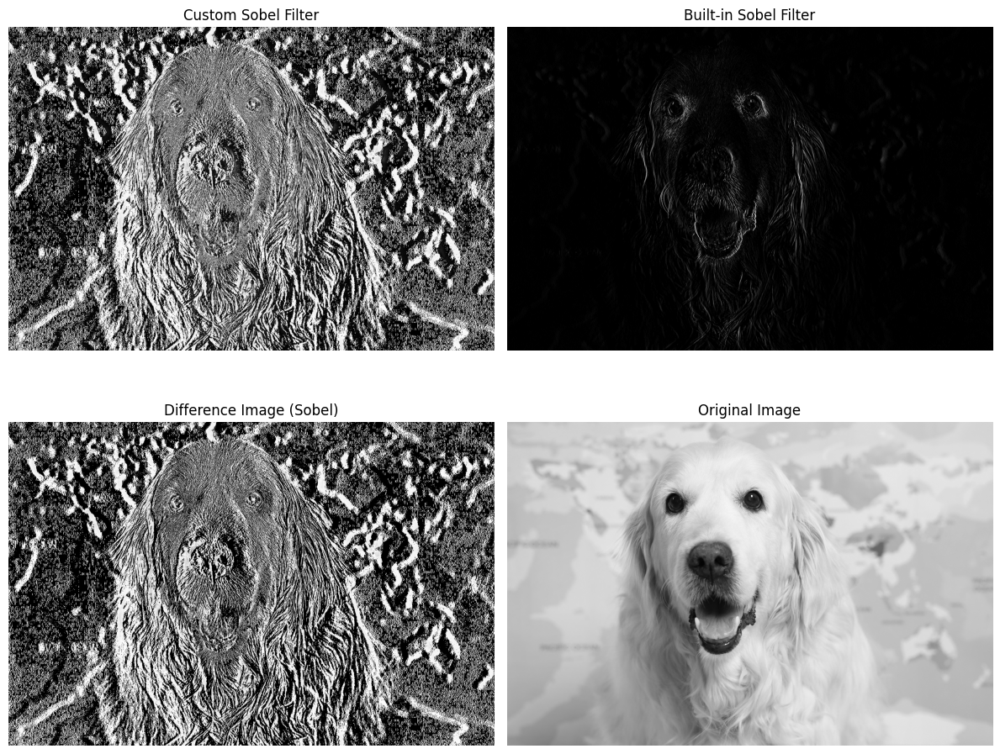

Applying Point filter...


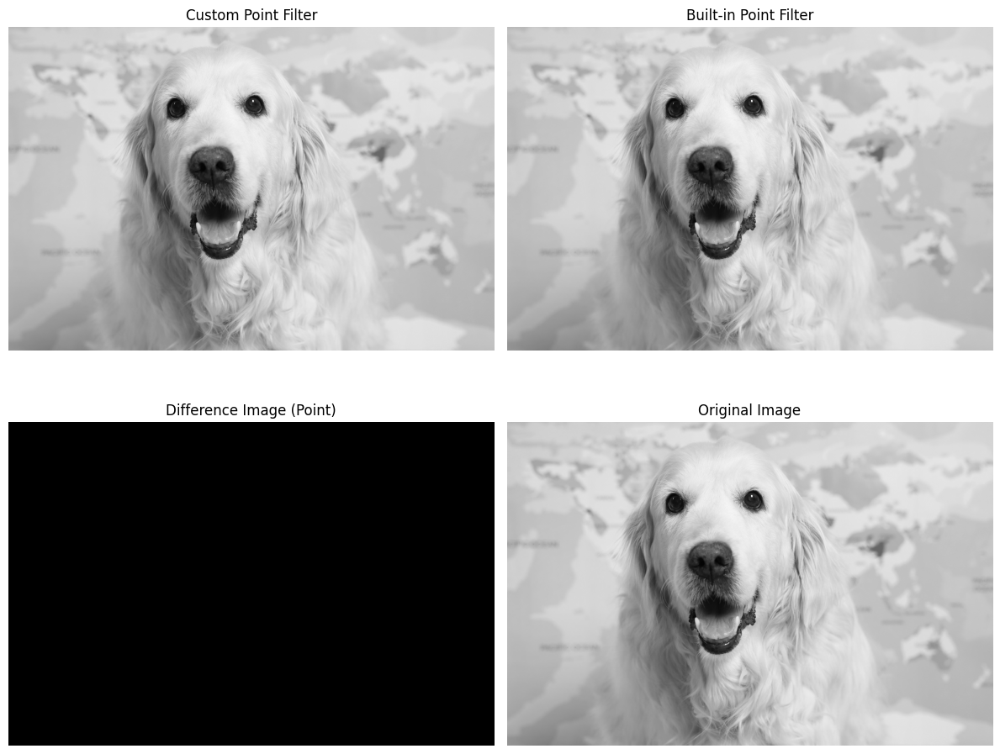

Applying Blurring filter...


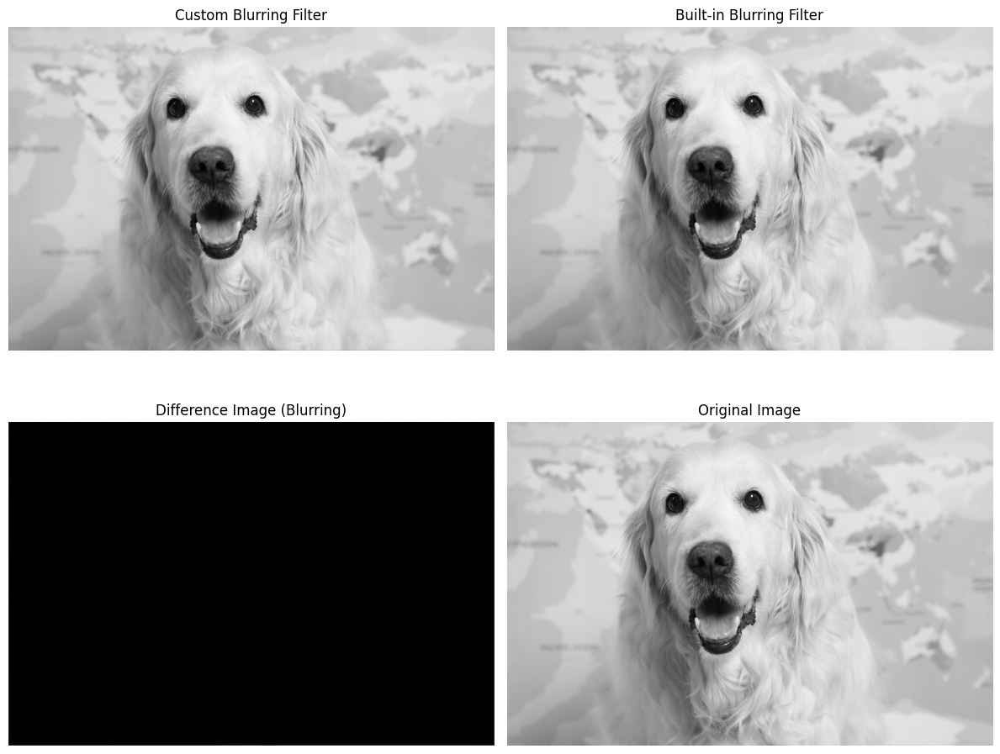

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


def custom_filter(image, kernel):
    """
    Apply linear filtering manually by computing the sum of products for each pixel.
    Assumption: Uses zero-padding to keep the image size the same.
    """
    img_h, img_w = image.shape
    kernel_h, kernel_w = kernel.shape
    pad_h, pad_w = kernel_h // 2, kernel_w // 2

    # Create a padded version of the image
    padded_image = np.pad(image, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant', constant_values=0)

    # Create an empty output image
    filtered_image = np.zeros_like(image)

    # Perform convolution manually
    for i in range(img_h):
        for j in range(img_w):
            region = padded_image[i:i + kernel_h, j:j + kernel_w]
            filtered_image[i, j] = np.sum(region * kernel)

    # Normalize the output
    filtered_image = np.clip(filtered_image, 0, 255).astype(np.uint8)

    return filtered_image


prewitt = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])  # Prewitt filter (Edge detection)
sobel = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])  # Sobel filter (Edge enhancement)
point_filter = np.array([[0, 0, 0], [0, 1, 0], [0, 0, 0]])  # Identity filter
blurring_filter = np.ones((3, 3), dtype=np.float32) / 9  # Blurring filter (Averaging)

# List of filters (4 total)
filters = {
    "Prewitt": prewitt,
    "Sobel": sobel,
    "Point": point_filter,
    "Blurring": blurring_filter
}

# List of images to process
image_paths = ["/content/Red-Fox.jpg", "/content/Pet_Cat.jpg", "/content/Goldie_boy.jpg"]

# Process each image
for idx, image_path in enumerate(image_paths):
    print(f"\n Processing Image {idx+1}: {image_path}\n")

    # Step 1: Read Image & Convert to Grayscale
    gray_img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Apply each filter (4 total)
    for filter_name, kernel in filters.items():
        print(f"Applying {filter_name} filter...")

        # Custom filtering
        custom_filtered = custom_filter(gray_img, kernel)

        # Built-in OpenCV filtering
        built_in_filtered = cv2.filter2D(gray_img, -1, kernel)

        # Compute difference image
        diff_image = cv2.absdiff(custom_filtered, built_in_filtered)

        # Display results in a 2-images-per-row layout (4 images total)
        fig, axes = plt.subplots(2, 2, figsize=(12, 10))

        axes[0, 0].imshow(custom_filtered, cmap='gray')
        axes[0, 0].axis('off')
        axes[0, 0].set_title(f'Custom {filter_name} Filter')

        axes[0, 1].imshow(built_in_filtered, cmap='gray')
        axes[0, 1].axis('off')
        axes[0, 1].set_title(f'Built-in {filter_name} Filter')

        axes[1, 0].imshow(diff_image, cmap='gray')
        axes[1, 0].axis('off')
        axes[1, 0].set_title(f'Difference Image ({filter_name})')

        axes[1, 1].imshow(gray_img, cmap='gray')
        axes[1, 1].axis('off')
        axes[1, 1].set_title('Original Image')

        plt.tight_layout()
        plt.show()

## Discussion of Results

### **Custom Filtering vs. Built-in Filtering**
- We implemented a **custom image filtering function** that applies linear filters pixel by pixel.
- The results from our function were compared against **OpenCV’s built-in filtering function (`cv2.filter2D`)**.

### **Observations on Filtered Images**
#### **Prewitt Filter (Edge Detection)**
- Detects **vertical edges** in the image.
- The **difference image is mostly dark**, meaning our custom filter performs well.

#### **Sobel Filter (Edge Enhancement)**
- Detects **stronger edge variations** compared to Prewitt.
- The **difference image** shows minor pixel variations due to floating-point precision differences.

#### **Point Filter (Identity)**
- The **custom function and built-in function produce identical outputs**.
- The **difference image is completely black**, confirming correct implementation.
- **Why?** The point filter does not modify pixel values, so both outputs are exactly the same. Since the difference is very minute and both images are identical, the result is **zero for all pixels**, making the difference image **completely black**.

#### **Blurring Filter**
- The **blurring effect smooths the image**, reducing high-frequency details.
- The **difference image is also completely black**, confirming that both implementations produce the same output.
- **Why?** A 3×3 averaging filter is applied in both the custom function and OpenCV’s built-in function. Since the calculations are exactly the same, the outputs match **pixel-for-pixel**, leading to a **black difference image**.

### **Difference Image Analysis**
- The difference images are **mostly dark**, meaning our custom filtering function closely matches OpenCV’s implementation.
- The most noticeable differences occur in **edge-detection filters (Prewitt, Sobel)** due to small numerical precision differences.
- The **Point Filter and Blurring Filter difference images are black**, confirming that both outputs are **identical**.

### **Assumptions in Custom Filtering**
- **Zero-padding was used** to maintain the same image size.
- **Floating-point precision differences may slightly affect results** in edge-detection filters.
- **Sum of products manually computed** in our function mimics convolution operation in OpenCV.

---

## **Final Summary**
- **Prewitt and Sobel filters** effectively highlight edges.
- **Point filter preserves the original image**, and the difference image is black because the outputs are identical.
- **Blurring filter smooths images, and the difference image is also black, confirming identical results.**
- The **difference images confirm that our custom function performs as expected**.

---


## Part 3 – Bit Plane Splicing

Bit place splicing (https://en.wikipedia.org/wiki/Bit_plane) is a simple form of frequency analysis in which the frequencies are defined by the bits representing the intensity of the pixels. Write a program to perform bit-plane splicing on the grayscale version of the input image, such that you can generate a figure similar to the one shown in the Wikipedia article: your original (grayscale) image and each of the 8-bit
planes in it. Each bit-position represents a different binary image. Some bit-level manipulation and additional math will be required to display the plane images as black and white images.

Then, “assemble” the original image by successively adding bit planes to the most significant bit plane. You will have 7 new images, which will be the combination of bit planes 7 and 6; 7 and 6 and 5; 7 and 6
and 5 and 4; … all bit planes, which should be the original image. Again, some math will be needed to make sure that your results are correct. State which bit plane you feel you could stop at and still get a good
visual match with the original image.

For every input image (you have 3 inputs, see Data), you must show: the original image, the bit planes images (8 images), and the results of gradually assembling the image (7 images)


 Processing Image 1: /content/Red-Fox.jpg



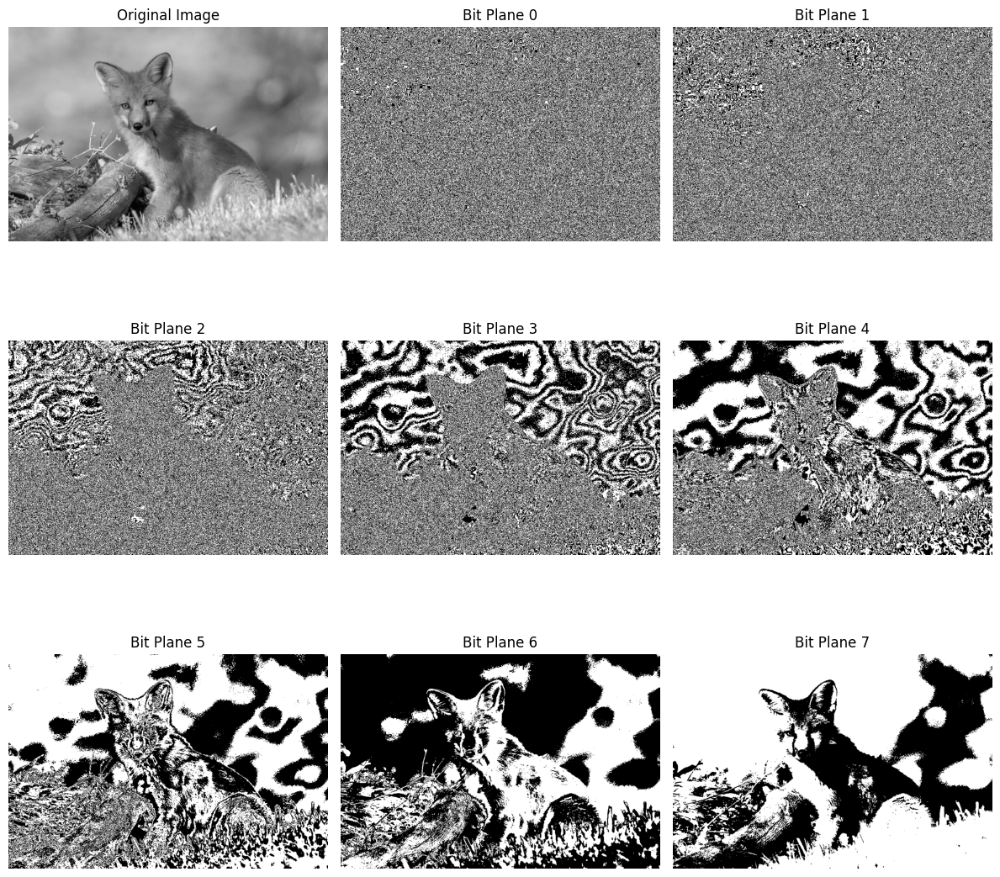

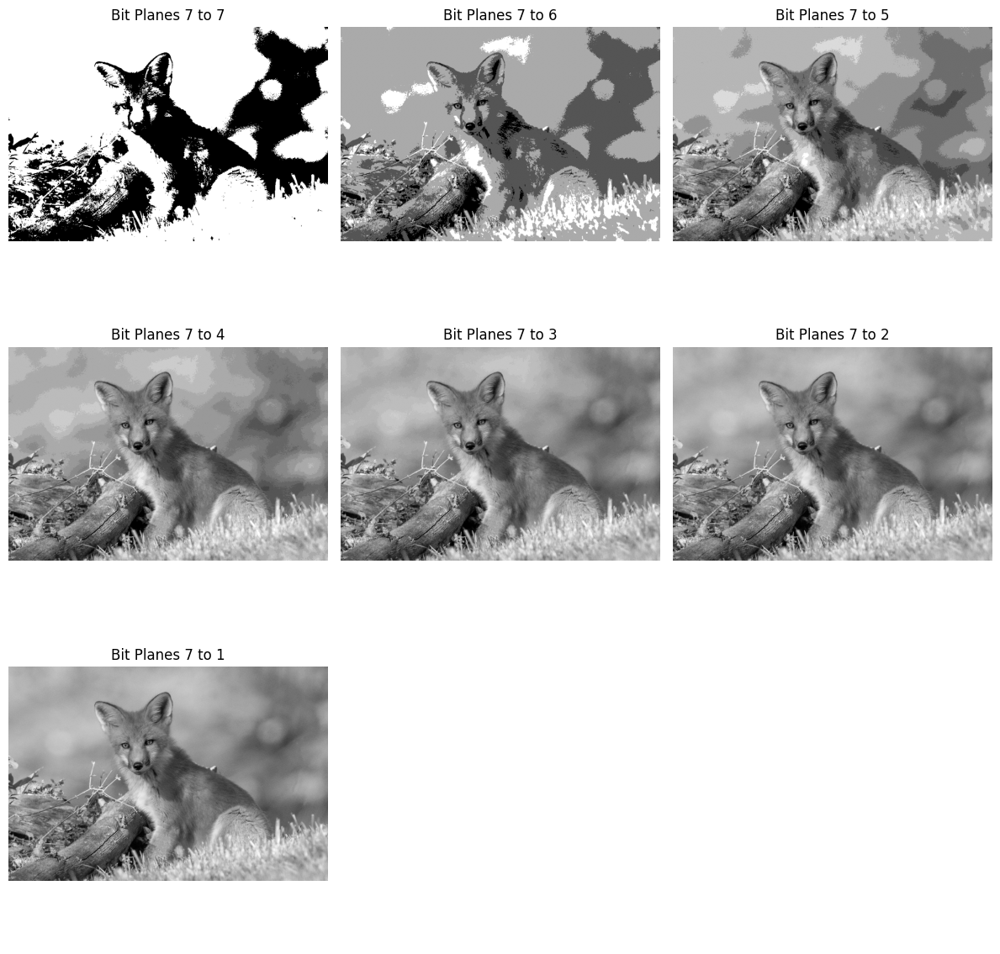


 Processing Image 2: /content/Pet_Cat.jpg



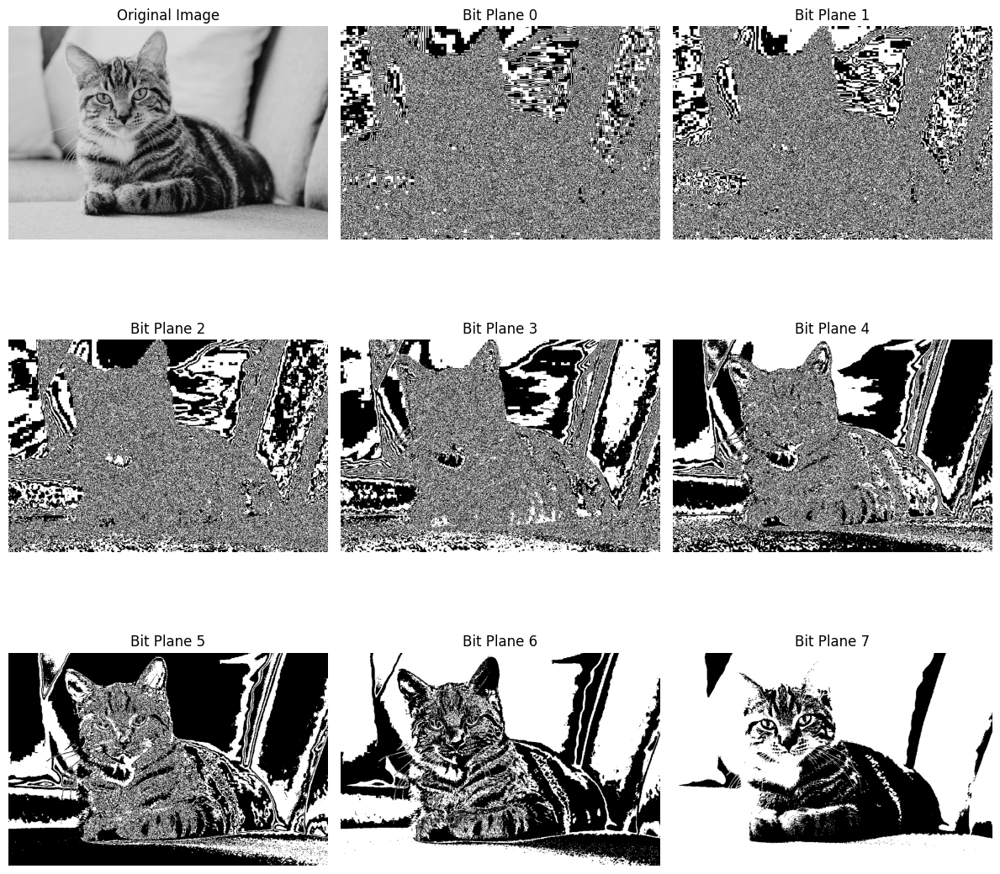

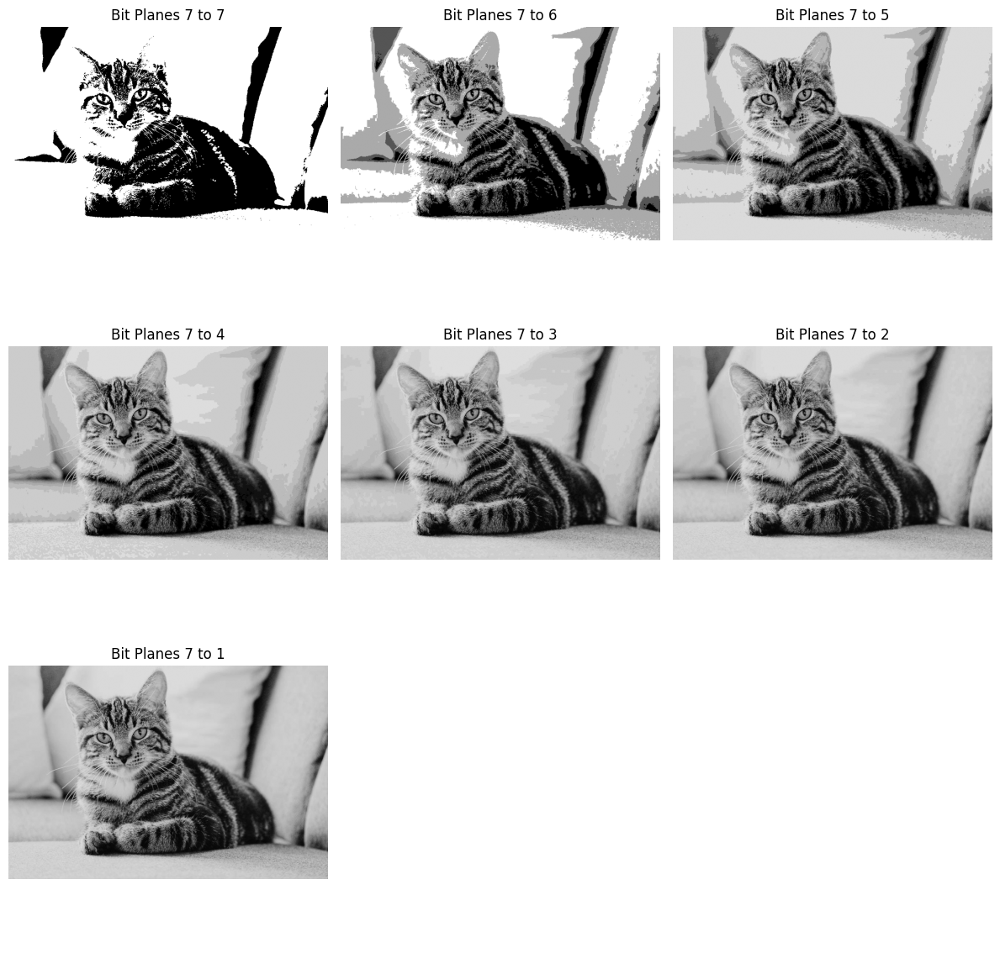


 Processing Image 3: /content/Goldie_boy.jpg



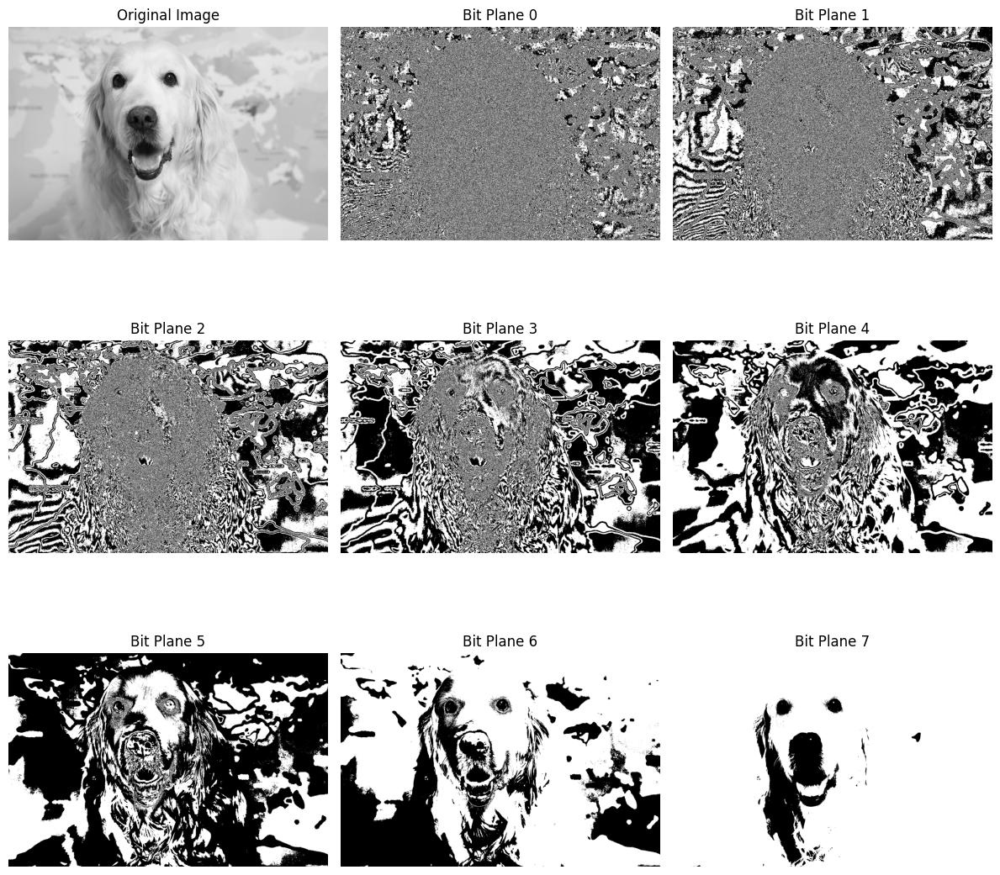

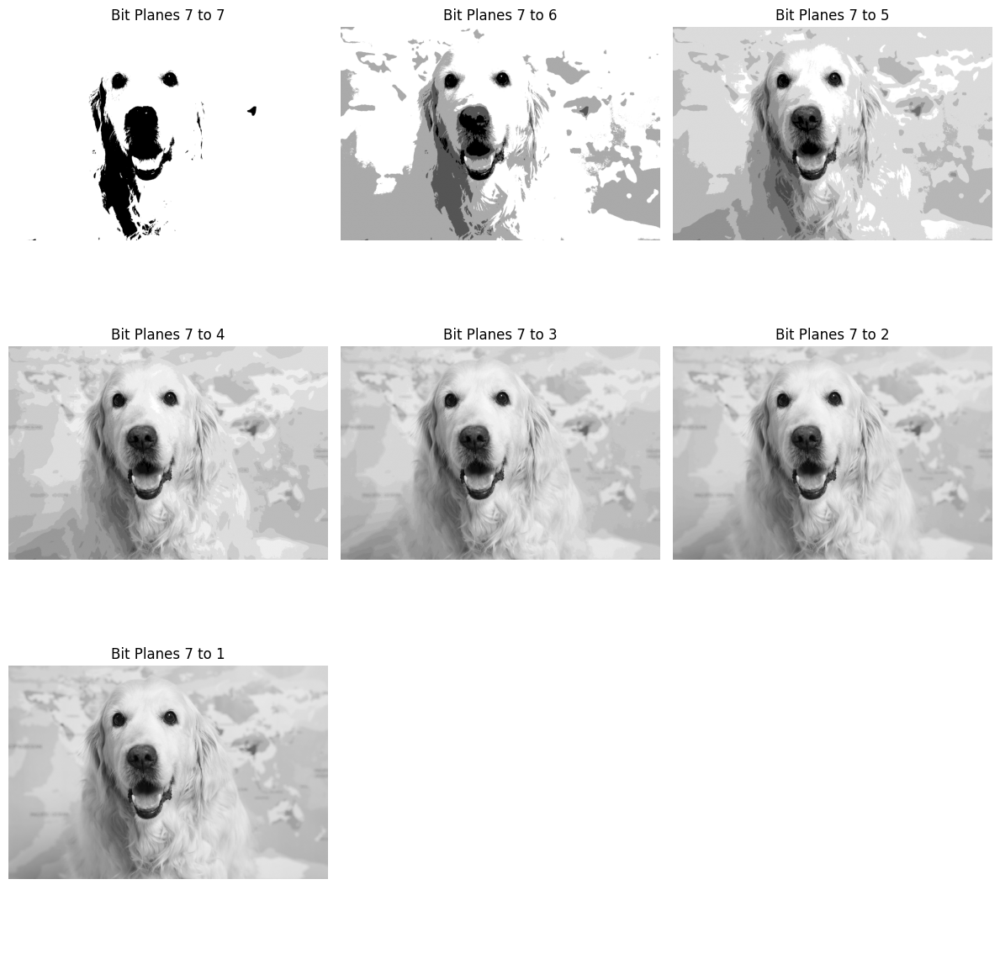

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to extract bit planes
def extract_bit_planes(image):
    bit_planes = []
    for i in range(8):  # 8-bit grayscale images have 8 planes (0-7)
        bit_plane = (image >> i) & 1  # Extract bit at position i
        bit_planes.append(bit_plane * 255)  # Scale for visualization
    return bit_planes

# Function to reconstruct the image by successively adding bit planes correctly
def reconstruct_image(bit_planes):
    reconstructed_images = []
    reconstruction = np.zeros_like(bit_planes[0], dtype=np.uint8)

    for i in range(7, -1, -1):  # Start from most significant bit (MSB) down to LSB
        reconstruction += (bit_planes[i] // 255) * (2 ** i)  # Proper bit-weighted addition
        reconstructed_images.append(reconstruction.copy())  # Store reconstruction at each step

    return reconstructed_images

# List of images to process
image_paths = ["/content/Red-Fox.jpg", "/content/Pet_Cat.jpg", "/content/Goldie_boy.jpg"]

# Process each image
for idx, image_path in enumerate(image_paths):
    print(f"\n Processing Image {idx+1}: {image_path}\n")

    # Step 1: Read Image & Convert to Grayscale
    gray_img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Step 2: Extract bit planes
    bit_planes = extract_bit_planes(gray_img)

    # Step 3: Display the original and bit planes
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))  # 3 rows, 3 columns
    axes[0, 0].imshow(gray_img, cmap='gray')
    axes[0, 0].axis('off')
    axes[0, 0].set_title("Original Image")

    for i in range(8):
        row, col = divmod(i + 1, 3)
        axes[row, col].imshow(bit_planes[i], cmap='gray')
        axes[row, col].axis('off')
        axes[row, col].set_title(f"Bit Plane {i}")

    plt.tight_layout()
    plt.show()

    # Step 4: Reconstruct images by progressively adding bit planes
    reconstructed_images = reconstruct_image(bit_planes)

    # Step 5: Display reconstructed images (7 images)
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))  # 3 rows, 3 columns

    for i in range(7):
        row, col = divmod(i, 3)
        axes[row, col].imshow(reconstructed_images[i], cmap='gray')
        axes[row, col].axis('off')
        axes[row, col].set_title(f"Bit Planes 7 to {7-i}")

    # Hide any unused subplots
    for j in range(7, 9):  # Only 7 images, but 9 slots in 3x3 grid
        row, col = divmod(j, 3)
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()


## Part 3 – Bit Plane Splicing

### **Introduction**
Bit-plane splicing is a **technique for analyzing image intensity variations** at different frequency levels. In an **8-bit grayscale image**, each pixel is represented by **8 bits (0-7)**.  
- **Higher bit planes (7,6,5)** store **major intensity variations** and contribute the most to the image.  
- **Lower bit planes (2,1,0)** store **minor intensity variations and noise**.  

### **Extracting Bit Planes**
We extract **all 8-bit planes** using bitwise operations:
- **Bit Plane 7 (Most Significant Bit - MSB)**: Contains the **most essential details** of the image.
- **Bit Plane 0 (Least Significant Bit - LSB)**: Contains **minor variations** and **background noise**.

#### **Observations on Bit Planes**
- **Bit Planes 7 to 5** preserve **high-frequency details and edges**.
- **Bit Planes 4 to 2** contain **finer texture variations**.
- **Bit Planes 1 and 0** appear mostly **random or noisy**.

### **Reconstructing the Image from Bit Planes**
The original image is reconstructed by **progressively adding bit planes** from **7 down to 0**.  
Each reconstructed image gets **closer to the original** as more planes are added.

#### **Observations on Reconstructed Images**
- **Using only Bit Planes 7 & 6** → The image is **visible but lacks details**.
- **Using Bit Planes 7, 6, 5, and 4** → The image is **almost fully restored**.
- **Using all Bit Planes 7 to 0** → The original image is **completely reconstructed**.

### **Identifying the Best Stopping Point**
Since **higher bit planes contain most of the meaningful data**, we determine the lowest bit-plane where the image is still recognizable.

**Conclusion:**

"A **good stopping point** for reconstructing the image while maintaining clarity is **Bit Plane 5 or Bit Plane 6**. These planes provide most structural details while ignoring noise from lower planes."

---

## **Final Summary**
**Bit-plane slicing effectively highlights different frequency components in an image.**  
**Higher bit planes (7-5) are the most important for image clarity.**  
**Lower bit planes (2-0) mainly contribute to fine details and noise.**  
**A clear image can be reconstructed using only Bit Planes 7, 6, and 5.**  

---
